# HOMEWORK 3

For this homework you are going to implement the **unsharp masking** filter (USM). It is a technique to improve the sharpness of an image by combining the image with its blurred (unsharp) version. See the Wikipedia [page](https://en.wikipedia.org/wiki/Unsharp_masking) for more details.

### Unsharp Masking (USP)
The USM technique consists of the following steps:
* Load the image you will be working with.
* Create a blurred (unsharp) version of the original image.
* Add the unsharp image (with a certain **weight**) to the original.

To sum it up, the USM performs the following operation:

`sharpened = original + (original − unsharp) × amount`

Even though we provide you an image to work with, you are welcome to use your own images :-)

In [1]:
import math

import cv2
import numpy as np
from matplotlib import pyplot as plt
plt.rcParams['figure.figsize'] = [15, 10]

In [2]:
def usm(img, amount, ksize=(5, 5), sigma=5):
    # Create a blurred (unsharp) version of the original image (you can use Gaussian blurring)
    unsharp = cv2.GaussianBlur(img, ksize=ksize, sigmaX=sigma)

    # Create the difference image (original − unsharp)
    # Note: Remember that you are working with uint8 data types. Any addition or substractions
    # might result in overflow or underflow, respectively. You can prevent this by casting the images to float.
    diff = img - unsharp

    # Apply USM to get the resulting image using `sharpened = original + (original − unsharp) × amount`
    # Note: Again, take care of underflows/overflows if necessary.
    sharpened = img + diff * amount
    sharpened[sharpened < 0] = 0
    sharpened[sharpened > 1] = 1

    # TODO: Should we clip diff BEFORE calculating sharpened image?
    diff_clipped = np.copy(diff)
    diff_clipped[diff < 0] = 0

    return img, sharpened, unsharp, diff_clipped

In [3]:
def plot_usm_result(img, sharpened, unsharp, diff_clipped):
    plt.rcParams['figure.figsize'] = [25, 18]
    plt.subplot(221, title='Original'), plt.imshow(img)
    plt.subplot(222, title='Blurred'), plt.imshow(unsharp)
    plt.subplot(223, title='Diff'), plt.imshow(diff_clipped)
    plt.subplot(224, title=f'Unsharp Masking'), plt.imshow(sharpened)

In [4]:
def load_img(filename):
    img = cv2.imread(filename)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    return img.astype(np.float32) / 255

### Results

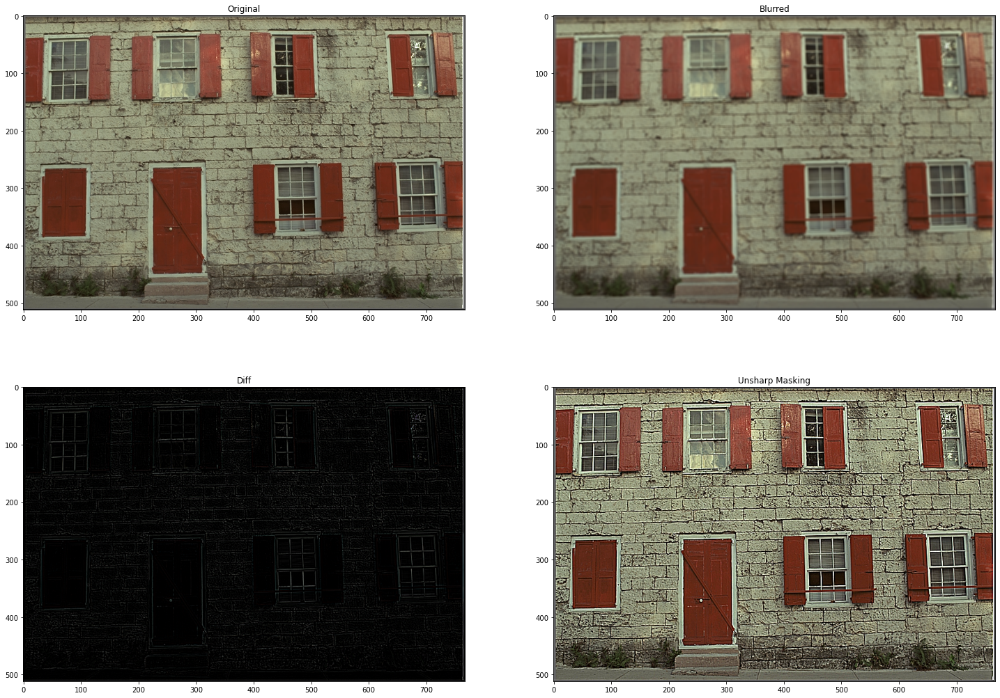

In [5]:
result = usm(load_img('data/kodim01.png'), amount=2, ksize=(5, 5), sigma=5)
plot_usm_result(*result)

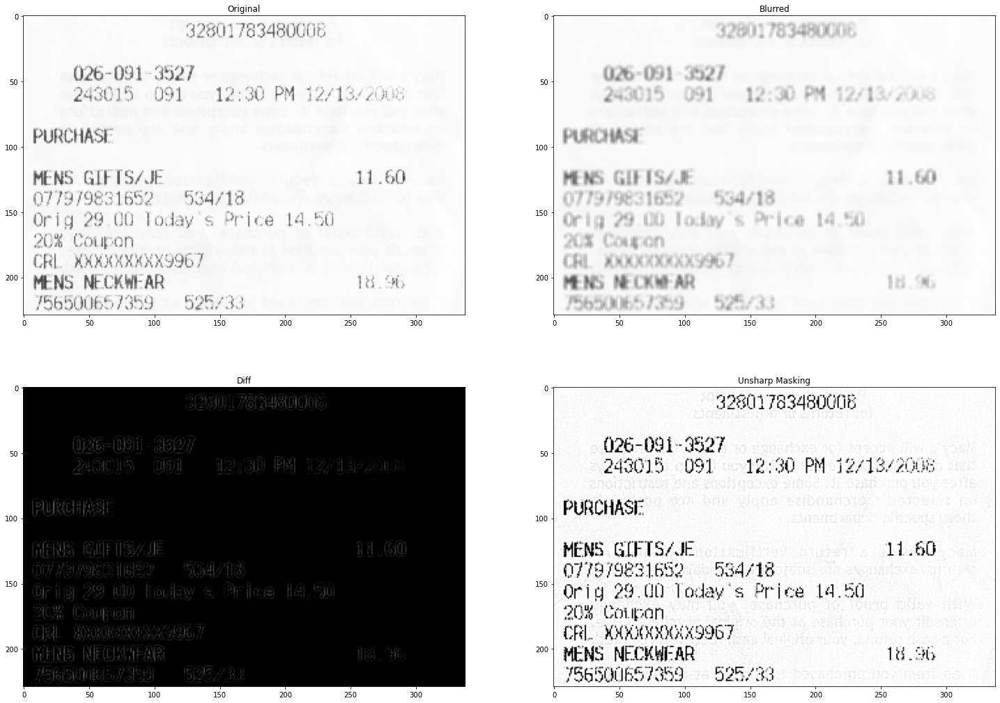

In [6]:
result = usm(load_img('data/scan.png'), amount=5, ksize=(3, 3), sigma=4)
plot_usm_result(*result)

In [7]:
def plot_usm_images(filename, amounts):
    img = load_img(filename)
    columns = 2
    rows = math.ceil(len(amounts) / columns)
    fig, axs = plt.subplots(rows, columns)
    fig.set_size_inches(columns * 10, rows * 8)
    for i in range(len(amounts)):
        row = i // columns
        col = i % columns
        amount = amounts[i]
        axs[row, col].imshow(usm(img, amount)[1])
        axs[row, col].set_title(f'amount = {amount}')
    fig.tight_layout()

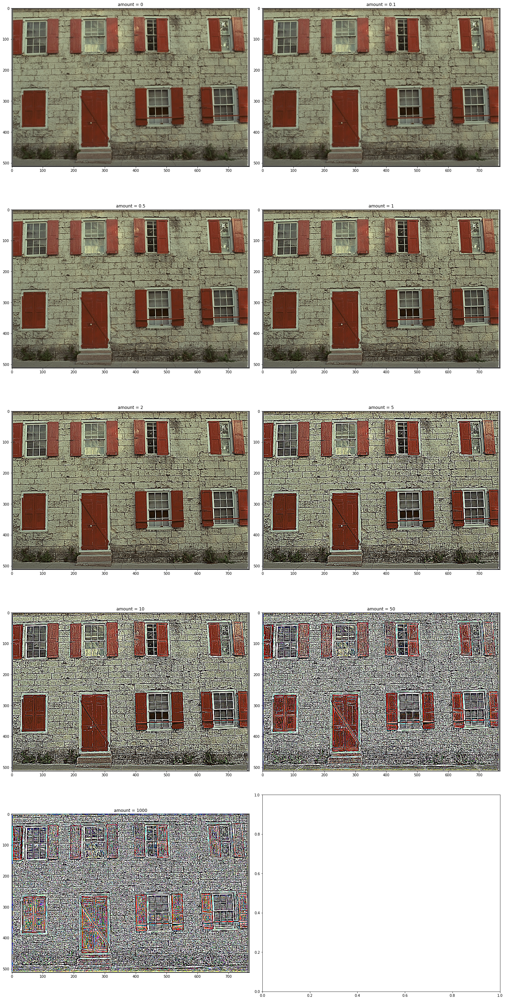

In [8]:
plot_usm_images('data/kodim01.png', amounts=(0, 0.1, 0.5, 1, 2, 3, 5, 10, 50, 1_000))

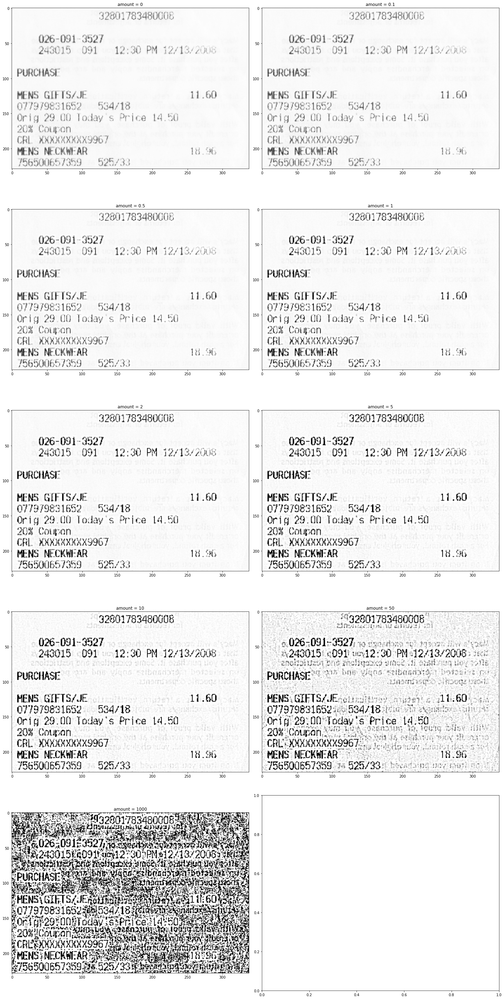

In [9]:
plot_usm_images('data/scan.png', amounts=(0, 0.1, 0.5, 1, 2, 5, 10, 50, 1_000))

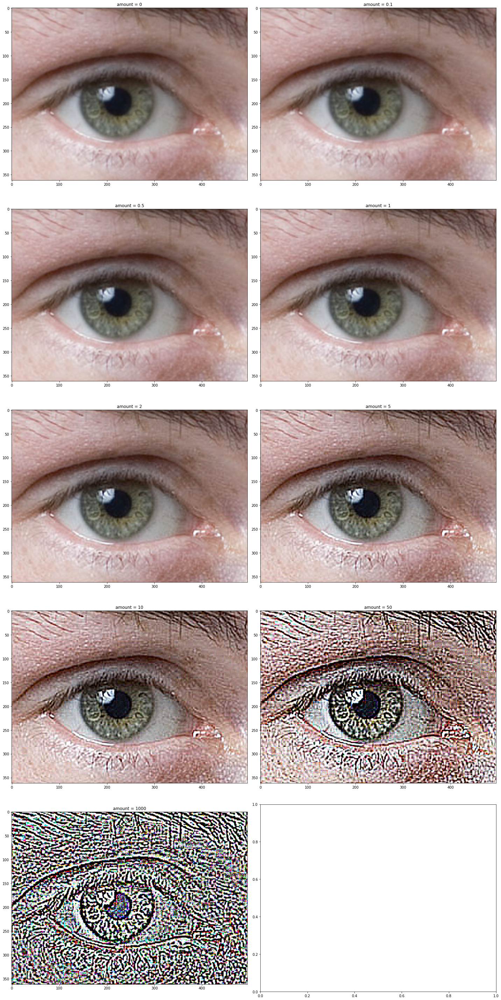

In [10]:
plot_usm_images('data/eye.png', amounts=(0, 0.1, 0.5, 1, 2, 5, 10, 50, 1_000))

### Questions
 * What is a good (reasonable) value for the `amount` parameter?
    * 0.5 - 5
 * What happens if it is too small?
    * Чем ближе значение amount к 0, тем ближе результат к оригинальному изображению.
    * Если amount < 0 - результат получается размытым
 * What happens if it is too large?
    * Проявляется слишком много мелких деталей